### Import libraries

In [117]:
from gc import collect

In [236]:
%matplotlib notebook

import glob
import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np
from pathlib import Path

import geojson as gj
import geopandas as gpd
import rasterio as rio

In [2]:
import torch
print(torch.__version__)

import lightning as L
print(L.__version__)

2.1.1
2.1.2


In [3]:
from lightning.pytorch import seed_everything
from lightning.pytorch.callbacks import EarlyStopping, ModelCheckpoint
from lightning.pytorch.loggers import TensorBoardLogger
from torchgeo.datamodules import InriaAerialImageLabelingDataModule
from torchgeo.trainers import SemanticSegmentationTask
from torchvision.models import ResNet50_Weights

/home/henriqueslab/Programs/miniconda3/envs/monai/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


### Data I/O

In [20]:
jpg_dir = Path("./data/")

In [24]:
# Get all filepaths of sharpened .jpg data
img_paths = sorted(jpg_dir.glob("*sharpened.jpg"))
len(img_paths)

6

In [207]:
# Get all filepaths original .jpg data
orig_img_paths = sorted(jpg_dir.glob("*[0-9].jp*"))
len(orig_img_paths)

6

In [4]:
data_dir = Path("/home/henriqueslab/laureho/projects/rs_datasets/Inria/")
export_dir = Path("./experiments/")

In [44]:
# Check Inria image properties
path = data_dir / "AerialImageDataset/train/images/austin1.tif"
with rio.open(path) as f:
    test = f.read()
    test_p = f.profile
test.shape, test_p

((3, 5000, 5000),
 {'driver': 'GTiff', 'dtype': 'uint8', 'nodata': None, 'width': 5000, 'height': 5000, 'count': 3, 'crs': CRS.from_epsg(26914), 'transform': Affine(0.29999999999997673, 0.0, 616500.0,
        0.0, -0.30000000000009314, 3345000.0), 'blockysize': 1, 'tiled': False, 'interleave': 'pixel'})

In [5]:
# Set deterministic seed for reproducibility
seed_everything(193, workers=True)

BATCH_SIZE = 64
NUM_WORKERS = 16
EPOCHS = 100

Seed set to 193


In [6]:
datamodule = InriaAerialImageLabelingDataModule(
    root=str(data_dir), batch_size=BATCH_SIZE, num_workers=NUM_WORKERS
    )
task = SemanticSegmentationTask(
    model="unet", 
    backbone="resnet50", 
    weights=ResNet50_Weights.IMAGENET1K_V2,
    lr=0.006,
    num_classes=2, 
    loss="jaccard"
    )

In [7]:
accelerator = "gpu" if torch.cuda.is_available() else "cpu"

checkpoint_callback = ModelCheckpoint(
    monitor="val_MulticlassJaccardIndex",
    mode="max",
    filename="{epoch}-{val_MulticlassJaccardIndex:.2f}",
    every_n_epochs=2,
    save_top_k=3,
    enable_version_counter=True,
    save_last=True

)
logger = TensorBoardLogger(save_dir=export_dir, name="unet_resnet50_logs")

In [8]:
# NO early stopping
trainer = L.Trainer(
    deterministic=True,
    accelerator=accelerator,
    default_root_dir=export_dir,
    callbacks=[checkpoint_callback],
    fast_dev_run=False,
    log_every_n_steps=50,
    check_val_every_n_epoch=1,
    logger=logger,
    min_epochs=1,
    max_epochs=EPOCHS,
)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


### Training

In [9]:
trainer.fit(model=task, datamodule=datamodule)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | JaccardLoss      | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | test_metrics  | MetricCollection | 0     
4 | model         | Unet             | 32.5 M
---------------------------------------------------
32.5 M    Trainable params
0         Non-trainable params
32.5 M    Total params
130.085   Total estimated model params size (MB)


Epoch 0: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:53<00:00,  2.89it/s, v_num=4]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Epoch 1: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:55<00:00,  2.80it/s, v_num=4]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  64%|██████████████████████████████████████████████████████████████▋                                   | 16/25 [00:06<00:03,  2.43it/s]


Epoch 2: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:55<00:00,  2.80it/s, v_num=4]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Epoch 3: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:55<00:00,  2.80it/s, v_num=4]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  28%|███████████████████████████▋                                                                       | 7/25 [00:03<00:08,  2.15it/s]


Epoch 4: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:55<00:00,  2.81it/s, v_num=4]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Epoch 5: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:55<00:00,  2.79it/s, v_num=4]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]


Epoch 6: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:56<00:00,  2.76it/s, v_num=4]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  72%|██████████████████████████████████████████████████████████████████████▌                           | 18/25 [00:07<00:02,  2.47it/s]


Epoch 7: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:56<00:00,  2.76it/s, v_num=4]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Epoch 8: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:54<00:00,  2.82it/s, v_num=4]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  36%|███████████████████████████████████▋                                                               | 9/25 [00:04<00:07,  2.19it/s]


Epoch 9: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:56<00:00,  2.73it/s, v_num=4]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Epoch 10: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:55<00:00,  2.80it/s, v_num=4]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:   0%|                                                                                                           | 0/25 [00:00<?, ?it/s]


Epoch 11: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:55<00:00,  2.81it/s, v_num=4]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  80%|██████████████████████████████████████████████████████████████████████████████▍                   | 20/25 [00:06<00:01,  2.92it/s]


Epoch 12:  13%|█████████████▎                                                                                         | 20/155 [00:11<01:17,  1.73it/s, v_num=4]

/home/henriqueslab/Programs/miniconda3/envs/monai/lib/python3.9/site-packages/lightning/pytorch/trainer/call.py:54: Detected KeyboardInterrupt, attempting graceful shutdown...


**Resume training from checkpoint**

In [18]:
trainer.fit(ckpt_path="./experiments/unet_resnet50_logs/version_2/checkpoints/epoch-val_MulticlassJaccardIndex=0.67.ckpt", model=task, datamodule=datamodule)

Restoring states from the checkpoint path at ./experiments/unet_resnet50_logs/version_4/checkpoints/epoch-val_MulticlassJaccardIndex=0.67.ckpt
/home/henriqueslab/Programs/miniconda3/envs/monai/lib/python3.9/site-packages/lightning/pytorch/callbacks/model_checkpoint.py:347: The dirpath has changed from 'experiments/unet_resnet50_logs/version_4/checkpoints' to 'experiments/unet_resnet50_logs/version_5/checkpoints', therefore `best_model_score`, `kth_best_model_path`, `kth_value`, `last_model_path` and `best_k_models` won't be reloaded. Only `best_model_path` will be reloaded.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name          | Type             | Params
---------------------------------------------------
0 | criterion     | JaccardLoss      | 0     
1 | train_metrics | MetricCollection | 0     
2 | val_metrics   | MetricCollection | 0     
3 | test_metrics  | MetricCollection | 0     
4 | model         | Unet             | 32.5 M
------------------------------------------------

Epoch 10: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [01:01<00:00,  2.54it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Epoch 11: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:56<00:00,  2.74it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  64%|██████████████████████████████████████████████████████████████▋                                   | 16/25 [00:06<00:03,  2.54it/s]


Epoch 12: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:57<00:00,  2.69it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Epoch 13: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:57<00:00,  2.67it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  28%|███████████████████████████▋                                                                       | 7/25 [00:03<00:08,  2.10it/s]


Epoch 14: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:57<00:00,  2.70it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Epoch 15: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:57<00:00,  2.72it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]


Epoch 16: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:56<00:00,  2.73it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  72%|██████████████████████████████████████████████████████████████████████▌                           | 18/25 [00:06<00:02,  2.69it/s]


Epoch 17: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:56<00:00,  2.75it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Epoch 18: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:56<00:00,  2.75it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  36%|███████████████████████████████████▋                                                               | 9/25 [00:04<00:08,  1.93it/s]


Epoch 19: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:56<00:00,  2.74it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Epoch 20: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:57<00:00,  2.68it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:   0%|                                                                                                           | 0/25 [00:00<?, ?it/s]


Epoch 21: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:57<00:00,  2.72it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  80%|██████████████████████████████████████████████████████████████████████████████▍                   | 20/25 [00:07<00:01,  2.84it/s]


Epoch 22: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:57<00:00,  2.69it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Epoch 23: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:57<00:00,  2.70it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  44%|███████████████████████████████████████████                                                       | 11/25 [00:04<00:06,  2.25it/s]


Epoch 24: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:56<00:00,  2.73it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Epoch 25: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:56<00:00,  2.74it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:   8%|███████▉                                                                                           | 2/25 [00:01<00:12,  1.83it/s]


Epoch 26: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:56<00:00,  2.73it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  88%|██████████████████████████████████████████████████████████████████████████████████████▏           | 22/25 [00:07<00:01,  2.96it/s]


Epoch 27: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:57<00:00,  2.70it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Epoch 28: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:57<00:00,  2.68it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  52%|██████████████████████████████████████████████████▉                                               | 13/25 [00:05<00:04,  2.47it/s]


Epoch 29: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:56<00:00,  2.72it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Epoch 30: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:57<00:00,  2.70it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  16%|███████████████▊                                                                                   | 4/25 [00:01<00:10,  2.07it/s]


Epoch 31: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:56<00:00,  2.73it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  96%|██████████████████████████████████████████████████████████████████████████████████████████████    | 24/25 [00:07<00:00,  3.03it/s]


Epoch 32: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:57<00:00,  2.71it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Epoch 33: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:57<00:00,  2.70it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  60%|██████████████████████████████████████████████████████████▊                                       | 15/25 [00:06<00:04,  2.20it/s]


Epoch 34: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:58<00:00,  2.67it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Epoch 35: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:57<00:00,  2.68it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  24%|███████████████████████▊                                                                           | 6/25 [00:02<00:09,  2.06it/s]


Epoch 36: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:58<00:00,  2.66it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Epoch 37: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:58<00:00,  2.67it/s, v_num=5]


Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Epoch 38: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:57<00:00,  2.67it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  68%|██████████████████████████████████████████████████████████████████▋                               | 17/25 [00:06<00:02,  2.75it/s]


Epoch 39: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:56<00:00,  2.73it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Epoch 40: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:57<00:00,  2.71it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  32%|███████████████████████████████▋                                                                   | 8/25 [00:04<00:10,  1.69it/s]


Epoch 41: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:58<00:00,  2.67it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Epoch 42: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:58<00:00,  2.67it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation:   0%|                                                                                                                        | 0/25 [00:00<?, ?it/s]


Epoch 43: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:58<00:00,  2.64it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  76%|██████████████████████████████████████████████████████████████████████████▍                       | 19/25 [00:06<00:02,  2.72it/s]


Epoch 44: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:57<00:00,  2.69it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Epoch 45: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:56<00:00,  2.75it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  40%|███████████████████████████████████████▏                                                          | 10/25 [00:04<00:06,  2.29it/s]


Epoch 46: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:56<00:00,  2.74it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Epoch 47: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:55<00:00,  2.78it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:   4%|███▉                                                                                               | 1/25 [00:00<00:09,  2.47it/s]


Epoch 48: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:57<00:00,  2.68it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  84%|██████████████████████████████████████████████████████████████████████████████████▎               | 21/25 [00:08<00:01,  2.51it/s]


Epoch 49: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:57<00:00,  2.69it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Epoch 50: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:56<00:00,  2.76it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  48%|███████████████████████████████████████████████                                                   | 12/25 [00:05<00:05,  2.38it/s]


Epoch 51: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:56<00:00,  2.76it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Epoch 52: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:58<00:00,  2.67it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  12%|███████████▉                                                                                       | 3/25 [00:01<00:10,  2.17it/s]


Epoch 53: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:57<00:00,  2.70it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  92%|██████████████████████████████████████████████████████████████████████████████████████████▏       | 23/25 [00:07<00:00,  2.94it/s]


Epoch 54: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [01:00<00:00,  2.57it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Epoch 55: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:57<00:00,  2.68it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  56%|██████████████████████████████████████████████████████▉                                           | 14/25 [00:05<00:04,  2.57it/s]


Epoch 56: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:57<00:00,  2.68it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Epoch 57: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:57<00:00,  2.69it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  20%|███████████████████▊                                                                               | 5/25 [00:02<00:10,  1.99it/s]


Epoch 58: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:58<00:00,  2.66it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:08<00:00,  3.01it/s]


Epoch 59: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:57<00:00,  2.70it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Epoch 60: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:57<00:00,  2.68it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  64%|██████████████████████████████████████████████████████████████▋                                   | 16/25 [00:05<00:03,  2.76it/s]


Epoch 61: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:56<00:00,  2.77it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Epoch 62: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:55<00:00,  2.77it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  28%|███████████████████████████▋                                                                       | 7/25 [00:03<00:08,  2.21it/s]


Epoch 63: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:55<00:00,  2.77it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Epoch 64: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:55<00:00,  2.80it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]


Epoch 65: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:56<00:00,  2.75it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  72%|██████████████████████████████████████████████████████████████████████▌                           | 18/25 [00:06<00:02,  2.77it/s]


Epoch 66: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:55<00:00,  2.77it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Epoch 67: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:55<00:00,  2.78it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  36%|███████████████████████████████████▋                                                               | 9/25 [00:04<00:07,  2.21it/s]


Epoch 68: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:56<00:00,  2.75it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Epoch 69: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:55<00:00,  2.79it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:   0%|                                                                                                           | 0/25 [00:00<?, ?it/s]


Epoch 70: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:54<00:00,  2.83it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  80%|██████████████████████████████████████████████████████████████████████████████▍                   | 20/25 [00:07<00:01,  2.84it/s]


Epoch 71: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:54<00:00,  2.83it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Epoch 72: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:54<00:00,  2.85it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  44%|███████████████████████████████████████████                                                       | 11/25 [00:04<00:05,  2.40it/s]


Epoch 73: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:56<00:00,  2.73it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Epoch 74: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:54<00:00,  2.83it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:   8%|███████▉                                                                                           | 2/25 [00:01<00:11,  1.98it/s]


Epoch 75: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:54<00:00,  2.84it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  88%|██████████████████████████████████████████████████████████████████████████████████████▏           | 22/25 [00:07<00:00,  3.06it/s]


Epoch 76: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:54<00:00,  2.82it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Epoch 77: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:54<00:00,  2.83it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  52%|██████████████████████████████████████████████████▉                                               | 13/25 [00:05<00:04,  2.52it/s]


Epoch 78: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:54<00:00,  2.84it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Epoch 79: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:54<00:00,  2.83it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  16%|███████████████▊                                                                                   | 4/25 [00:01<00:09,  2.20it/s]


Epoch 80: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:54<00:00,  2.82it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  96%|██████████████████████████████████████████████████████████████████████████████████████████████    | 24/25 [00:07<00:00,  3.14it/s]


Epoch 81: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:54<00:00,  2.83it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Epoch 82: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:55<00:00,  2.81it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  60%|██████████████████████████████████████████████████████████▊                                       | 15/25 [00:05<00:03,  2.64it/s]


Epoch 83: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:54<00:00,  2.85it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Epoch 84: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:55<00:00,  2.82it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  24%|███████████████████████▊                                                                           | 6/25 [00:02<00:08,  2.27it/s]


Epoch 85: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:54<00:00,  2.82it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Epoch 86: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:54<00:00,  2.84it/s, v_num=5]


Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Epoch 87: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:54<00:00,  2.83it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  68%|██████████████████████████████████████████████████████████████████▋                               | 17/25 [00:06<00:02,  2.76it/s]


Epoch 88: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:54<00:00,  2.85it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Epoch 89: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:54<00:00,  2.85it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  32%|███████████████████████████████▋                                                                   | 8/25 [00:05<00:12,  1.37it/s]


Epoch 90: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:54<00:00,  2.84it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Epoch 91: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:54<00:00,  2.87it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation:   0%|                                                                                                                        | 0/25 [00:00<?, ?it/s]


Epoch 92: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:54<00:00,  2.82it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  76%|██████████████████████████████████████████████████████████████████████████▍                       | 19/25 [00:06<00:02,  2.88it/s]


Epoch 93: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:54<00:00,  2.84it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Epoch 94: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:55<00:00,  2.82it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  40%|███████████████████████████████████████▏                                                          | 10/25 [00:04<00:06,  2.20it/s]


Epoch 95: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:54<00:00,  2.84it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Epoch 96: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:54<00:00,  2.82it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:   4%|███▉                                                                                               | 1/25 [00:00<00:08,  2.74it/s]


Epoch 97: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:55<00:00,  2.81it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  84%|██████████████████████████████████████████████████████████████████████████████████▎               | 21/25 [00:06<00:01,  3.02it/s]


Epoch 98: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:54<00:00,  2.82it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Epoch 99: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [00:54<00:00,  2.84it/s, v_num=5]
Validation: |                                                                                                                             | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:  48%|███████████████████████████████████████████████                                                   | 12/25 [00:04<00:05,  2.46it/s]


Epoch 99: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [01:07<00:00,  2.28it/s, v_num=5]

`Trainer.fit` stopped: `max_epochs=100` reached.


Epoch 99: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 155/155 [01:07<00:00,  2.28it/s, v_num=5]


In [21]:
# Save weights of final model
trainer.save_checkpoint("./experiments/unet_resnet50_logs/version_3/checkpoints/final_model.ckpt", weights_only=True)

### Inference

In [183]:
def model_pred(model, img):
    """Use 'model' for inference on 'img', then clear img from GPU & free up memory."""
    
    img = (torch.from_numpy(img).unsqueeze(0)).float()
    img = img.to(device)
    with torch.inference_mode():
        pred = model(img).argmax(axis=1).cpu().numpy().squeeze()
    # Change prediction dtype to uint8
    pred = pred.astype(np.uint8)
    
    img = None
    collect()
    with torch.no_grad():
        torch.cuda.empty_cache()
    return pred

In [103]:
def show_pred(img, pred):
    """Plot original .jpg and model mask prediction side by side for comparison."""
    
    fig, axs = plt.subplots(1, 2, figsize=(10,4))
    axs[0].set_title("orig")
    axs[0].imshow(img)
    axs[1].set_title("pred")
    axs[1].imshow(pred)
    for a in axs:
        a.xaxis.set_visible(False)
        a.yaxis.set_visible(False)
    
    plt.tight_layout()
    plt.show()

**Get images to perform inference on**

In [31]:
# Load sharpened images
imgs = []
profiles = []
for p in img_paths:
    with rio.open(p) as f:
        imgs.append(f.read())
        profiles.append(f.profile)

In [208]:
# Load original images
orig_imgs = []
orig_profiles = []
for p in orig_img_paths:
    with rio.open(p) as f:
        orig_imgs.append(f.read())
        orig_profiles.append(f.profile)

/home/henriqueslab/Programs/miniconda3/envs/monai/lib/python3.9/site-packages/rasterio/__init__.py:304: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


In [209]:
orig_profiles

[{'driver': 'JPEG', 'dtype': 'uint8', 'nodata': None, 'width': 960, 'height': 600, 'count': 3, 'crs': None, 'transform': Affine(1.0, 0.0, 0.0,
        0.0, 1.0, 0.0), 'blockysize': 1, 'tiled': False, 'compress': 'jpeg', 'interleave': 'pixel', 'photometric': 'ycbcr'},
 {'driver': 'JPEG', 'dtype': 'uint8', 'nodata': None, 'width': 1368, 'height': 893, 'count': 3, 'crs': None, 'transform': Affine(1.0, 0.0, 0.0,
        0.0, 1.0, 0.0), 'blockysize': 1, 'tiled': False, 'compress': 'jpeg', 'interleave': 'pixel', 'photometric': 'ycbcr'},
 {'driver': 'JPEG', 'dtype': 'uint8', 'nodata': None, 'width': 1280, 'height': 815, 'count': 3, 'crs': None, 'transform': Affine(1.0, 0.0, 0.0,
        0.0, 1.0, 0.0), 'blockysize': 1, 'tiled': False, 'compress': 'jpeg', 'interleave': 'pixel', 'photometric': 'ycbcr'},
 {'driver': 'JPEG', 'dtype': 'uint8', 'nodata': None, 'width': 2046, 'height': 1147, 'count': 3, 'crs': None, 'transform': Affine(1.0, 0.0, 0.0,
        0.0, 1.0, 0.0), 'blockysize': 1, 'tiled':

In [40]:
# Check jpg image dimensions
for img in imgs:
    print(img.shape)

(3, 600, 960)
(3, 893, 1368)
(3, 815, 1280)
(3, 1147, 2046)
(3, 5619, 9569)
(3, 1155, 1920)


In [210]:
def pad_imgs(imgs):
    """Pad jpg images so that their dims are divisible by 32 as required for model inference."""
    test_imgs = []
    for img in imgs:
        dim1_divisible = (img.shape[1] // 32 + (img.shape[1] % 32 > 0)) * 32
        dim2_divisible = (img.shape[2] // 32 + (img.shape[2] % 32 > 0)) * 32
        if dim1_divisible > img.shape[1] and dim2_divisible > img.shape[2]:
            test_imgs.append(np.pad(img, ((0, 0), (dim1_divisible-img.shape[1], 0), (dim2_divisible-img.shape[2], 0)), "constant"))
        elif dim1_divisible > img.shape[1]:
            test_imgs.append(np.pad(img, ((0, 0), (dim1_divisible-img.shape[1], 0), (0, 0)), "constant"))
        elif dim2_divisible > img.shape[2]:
            test_imgs.append(np.pad(img, ((0, 0), (0, 0), (dim2_divisible-img.shape[2], 0)), "constant"))
        else:
            test_imgs.append(img)
    return test_imgs

In [112]:
# Dimensions of sharpened jpg images after padding
for t in test_imgs:
    print(t.shape)

(3, 608, 960)
(3, 896, 1376)
(3, 832, 1280)
(3, 1152, 2048)
(3, 5632, 9600)
(3, 1184, 1920)


In [211]:
test_orig_imgs = pad_imgs(orig_imgs)

In [212]:
# Dimensions of original jpg images after padding
for t in test_orig_imgs:
    print(t.shape)

(3, 608, 960)
(3, 896, 1376)
(3, 832, 1280)
(3, 1152, 2048)
(3, 5632, 9600)
(3, 1184, 1920)


In [33]:
# Set GPU
device = torch.device("cuda:0")

In [22]:
# Define model, convert to GPU and put in evaluation mode
model = task.model
model = model.to(device)
model = model.eval()

**Free up GPU memory when needed**

In [153]:
# cause new exception to free up state of old exception
1/0

ZeroDivisionError: division by zero

In [155]:
# clear GPU memory as necessary
img4 = None
collect()
with torch.no_grad():
    torch.cuda.empty_cache()

**Inference on all images**

In [127]:
# Memory error caused by image_5 being too big
preds = []
for t in test_imgs:
    tensor_img = (torch.from_numpy(t).unsqueeze(0)).float()
    tensor_img = tensor_img.to(device)
    with torch.inference_mode():
        preds.append(model(tensor_img).argmax(axis=1).cpu().numpy().squeeze())
    tensor_img = None
    collect()
    with torch.no_grad():
        torch.cuda.empty_cache()

OutOfMemoryError: CUDA out of memory. Tried to allocate 3.22 GiB. GPU 0 has a total capacty of 11.78 GiB of which 2.90 GiB is free. Including non-PyTorch memory, this process has 8.46 GiB memory in use. Of the allocated memory 5.57 GiB is allocated by PyTorch, and 1.63 GiB is reserved by PyTorch but unallocated. If reserved but unallocated memory is large try setting max_split_size_mb to avoid fragmentation.  See documentation for Memory Management and PYTORCH_CUDA_ALLOC_CONF

**image_1**

<IPython.core.display.Javascript object>


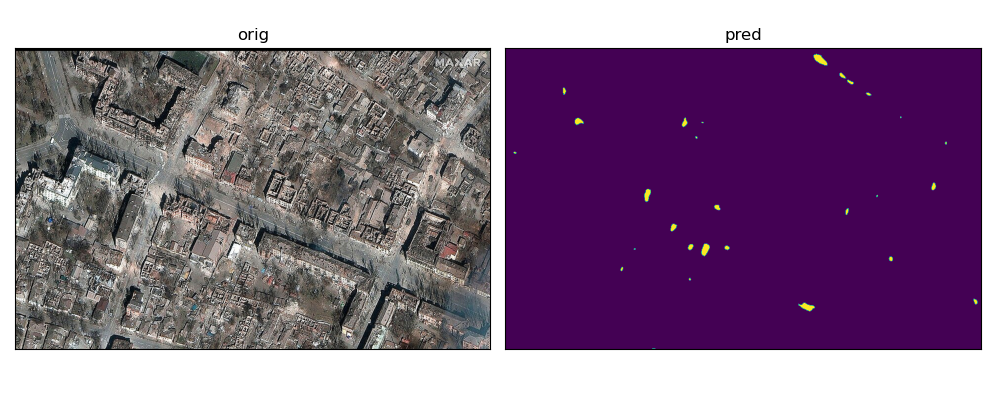

In [136]:
pred0 = model_pred(model, test_imgs[0])
show_pred(np.moveaxis(test_imgs[0], 0, -1), pred0)

<IPython.core.display.Javascript object>


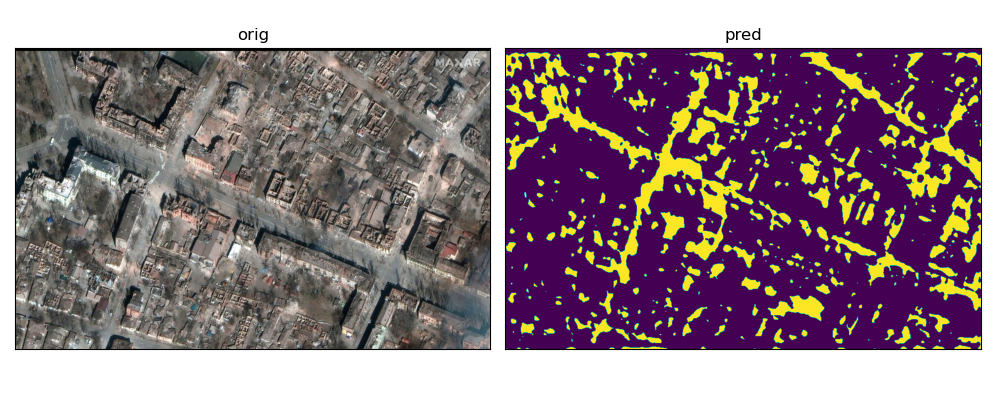

In [216]:
orig_pred0 = model_pred(model, test_orig_imgs[0])
show_pred(np.moveaxis(test_orig_imgs[0], 0, -1), orig_pred0)

**image_2**

<IPython.core.display.Javascript object>


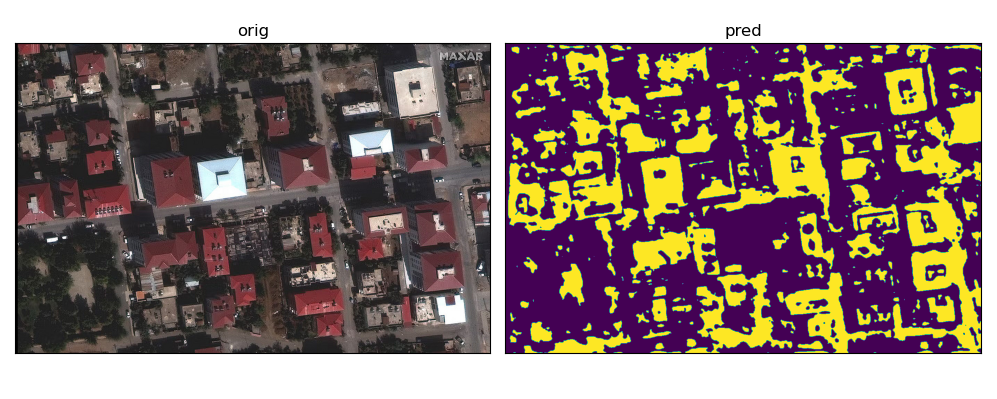

In [140]:
pred1 = model_pred(model, test_imgs[1])
show_pred(np.moveaxis(test_imgs[1], 0, -1), pred1)

<IPython.core.display.Javascript object>


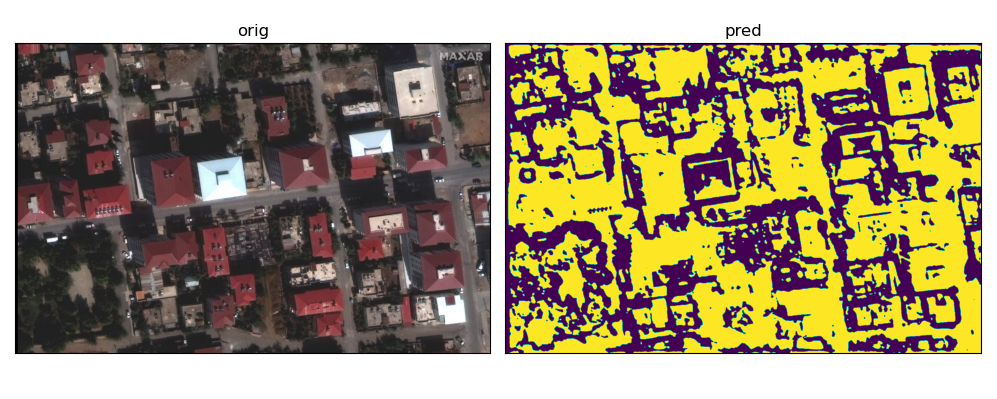

In [217]:
orig_pred1 = model_pred(model, test_orig_imgs[1])
show_pred(np.moveaxis(test_orig_imgs[1], 0, -1), orig_pred1)

**image_3**

<IPython.core.display.Javascript object>


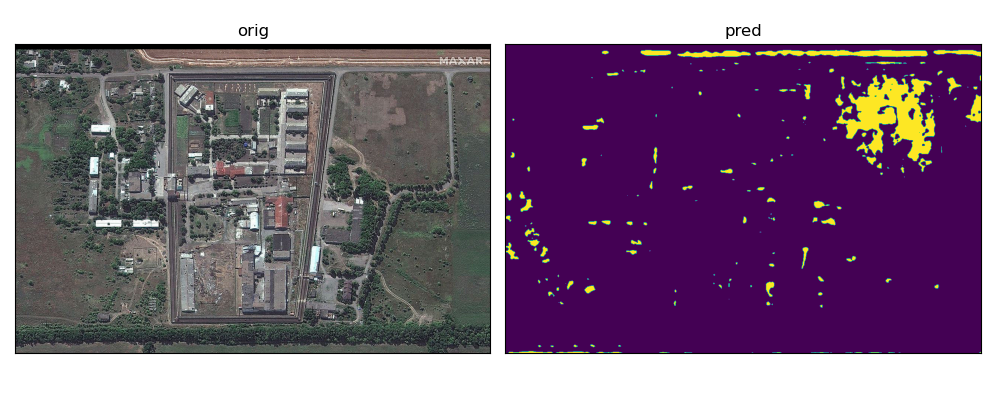

In [144]:
pred2 = model_pred(model, test_imgs[2])
show_pred(np.moveaxis(test_imgs[2], 0, -1), pred2)

<IPython.core.display.Javascript object>


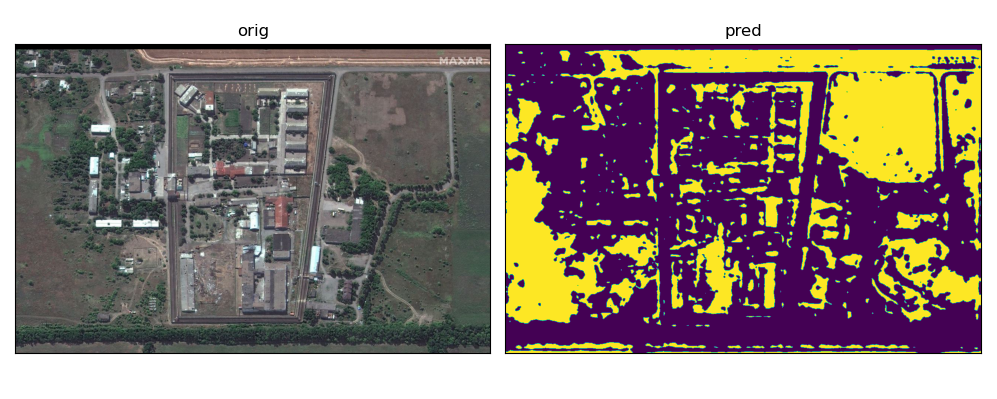

In [213]:
orig_pred2 = model_pred(model, test_orig_imgs[2])
show_pred(np.moveaxis(test_orig_imgs[2], 0, -1), orig_pred2)

**image_4**

<IPython.core.display.Javascript object>


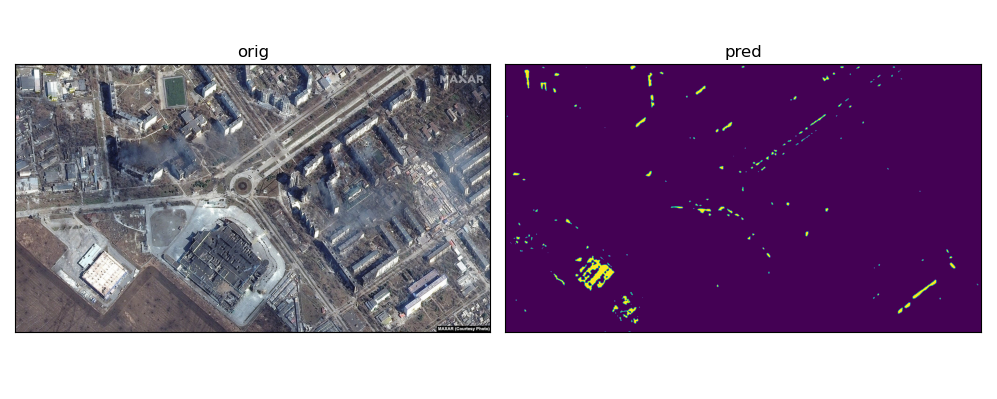

In [150]:
pred3 = model_pred(model, test_imgs[3])
show_pred(np.moveaxis(test_imgs[3], 0, -1), pred3)

<IPython.core.display.Javascript object>


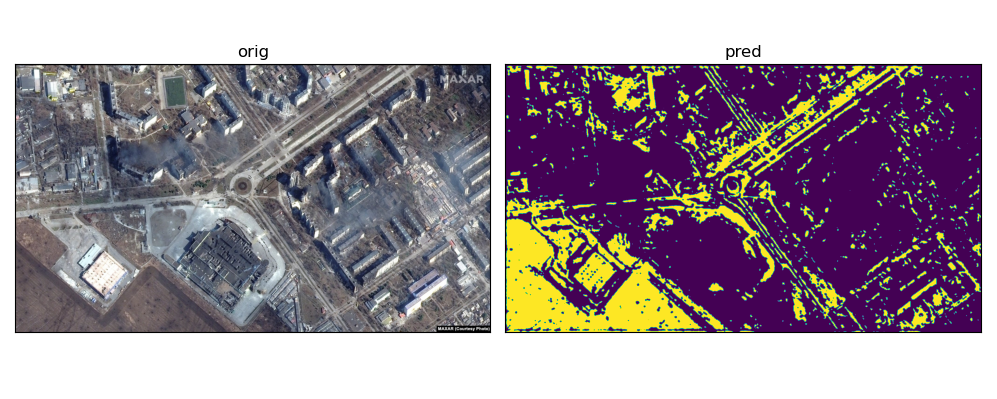

In [214]:
# original jpg
orig_pred3 = model_pred(model, test_orig_imgs[3])
show_pred(np.moveaxis(test_orig_imgs[3], 0, -1), orig_pred3)

**image_5**

In [158]:
test_imgs[4].shape

(3, 5632, 9600)

In [ ]:
# Tile image because original dimensions too big to fit in GPU
# -> results in 16 tiles of dims (1408, 2400)
tiled_img4 = np.moveaxis(test_imgs[4], 0, -1)
img_height, img_width, channels = tiled_img4.shape
tile_height = img_height // 4
tile_width = img_width // 4
tiled_img4 = tiled_img4.reshape(
    img_height // tile_height,
    tile_height,
    img_width // tile_width,
    tile_width,
    channels
)

In [161]:
# channel last order
tiled_img4 = tiled_img4.swapaxes(1, 2)
tiled_img4.shape

(4, 4, 1408, 2400, 3)

In [168]:
# channel first order
tiled_img4_ch = np.moveaxis(tiled_img4, -1, 2)
tiled_img4_ch.shape

(4, 4, 3, 1408, 2400)

0 0


<IPython.core.display.Javascript object>


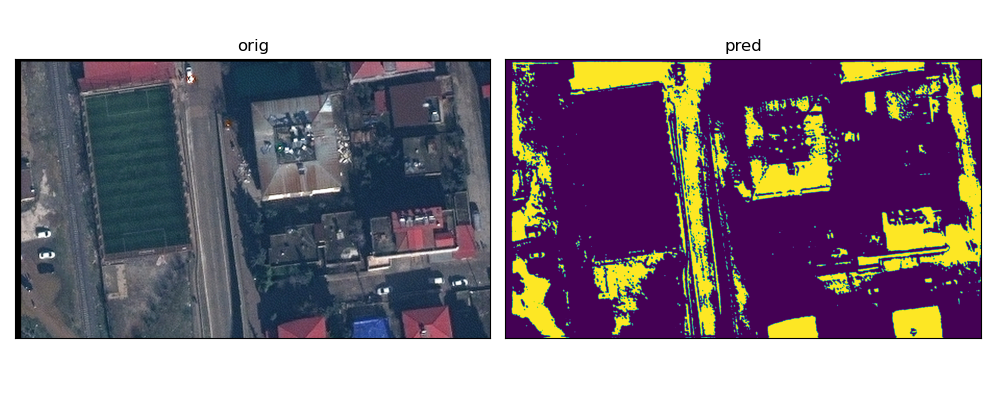

0 1


<IPython.core.display.Javascript object>


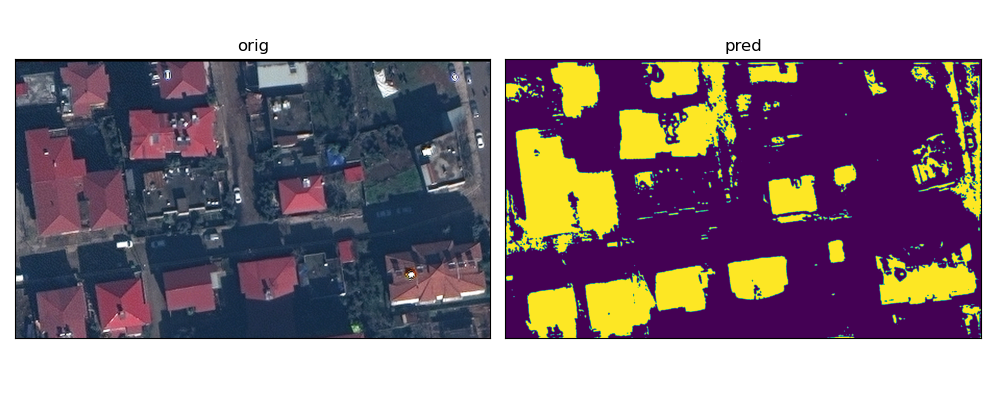

0 2


<IPython.core.display.Javascript object>


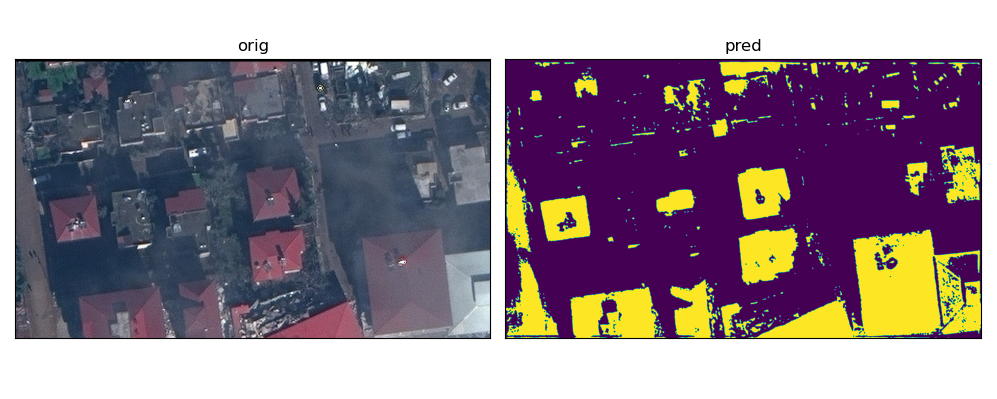

0 3


<IPython.core.display.Javascript object>


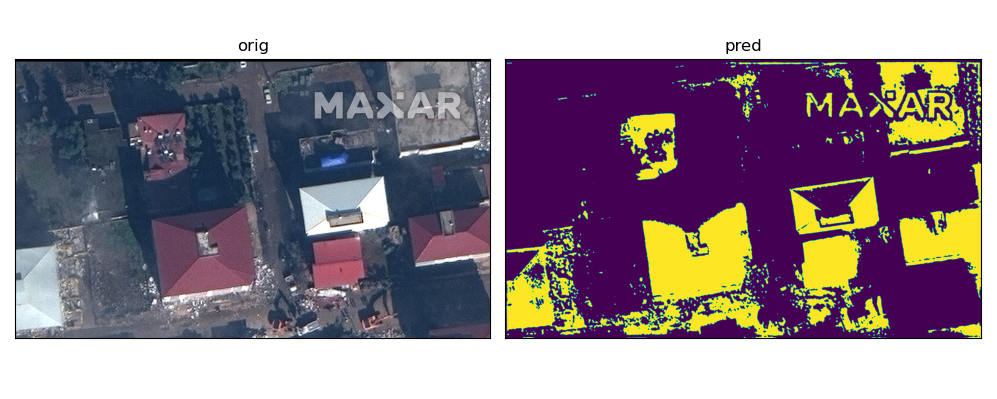

1 0


<IPython.core.display.Javascript object>


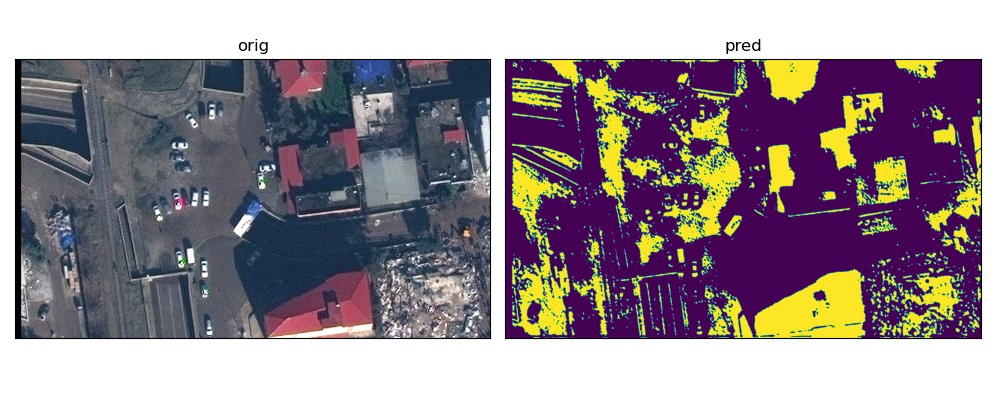

1 1


<IPython.core.display.Javascript object>


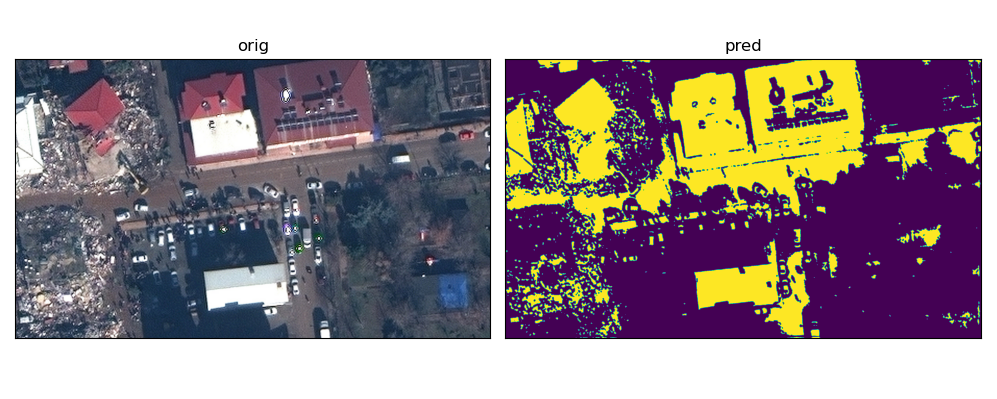

1 2


<IPython.core.display.Javascript object>


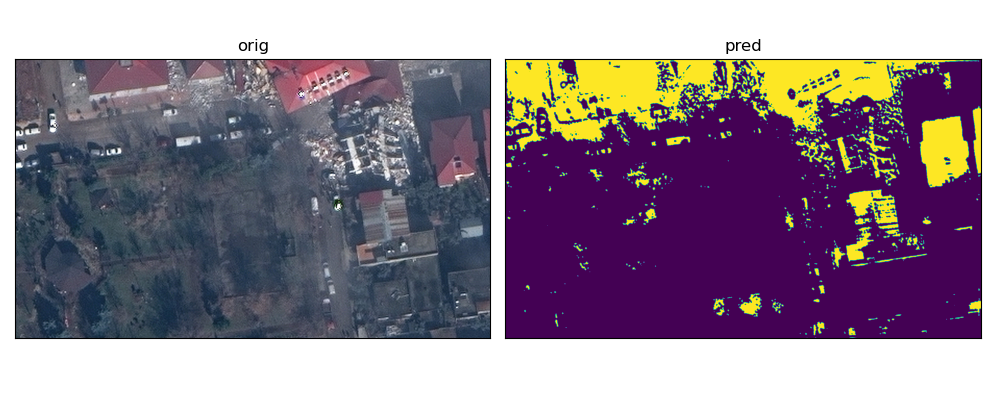

1 3


<IPython.core.display.Javascript object>


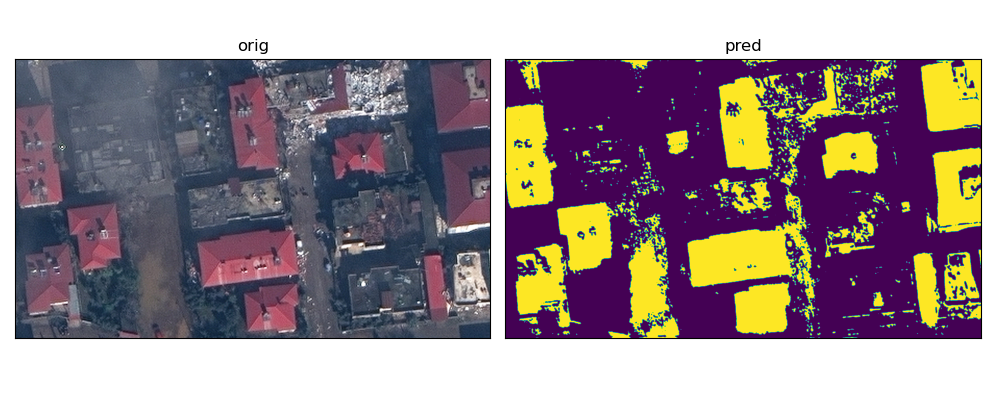

2 0


<IPython.core.display.Javascript object>


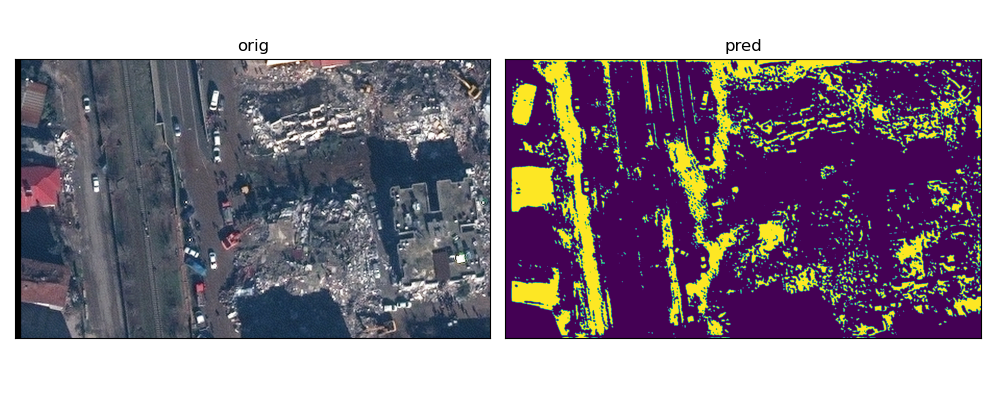

2 1


<IPython.core.display.Javascript object>


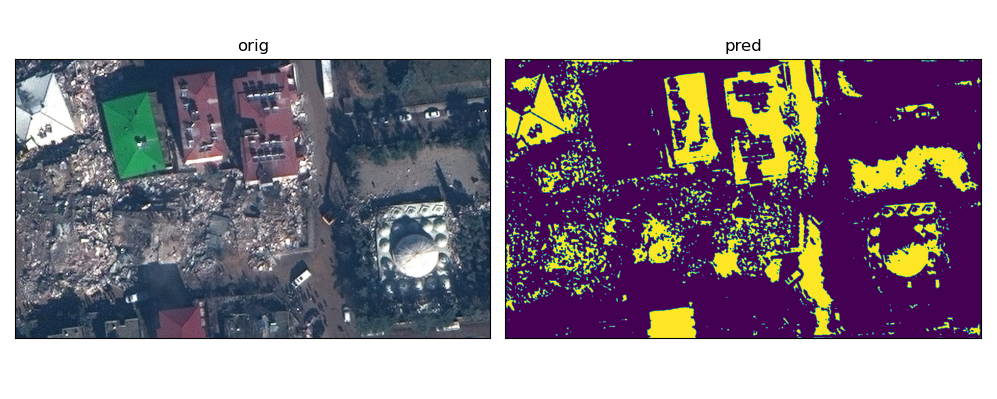

2 2


<IPython.core.display.Javascript object>


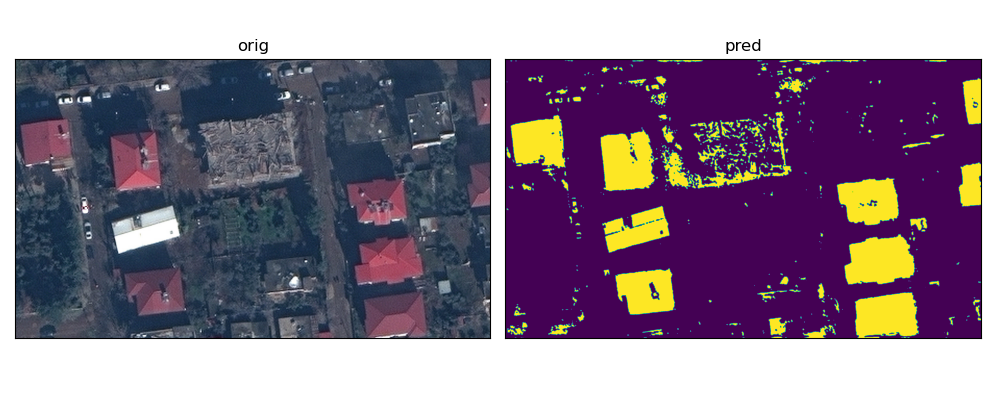

2 3


<IPython.core.display.Javascript object>


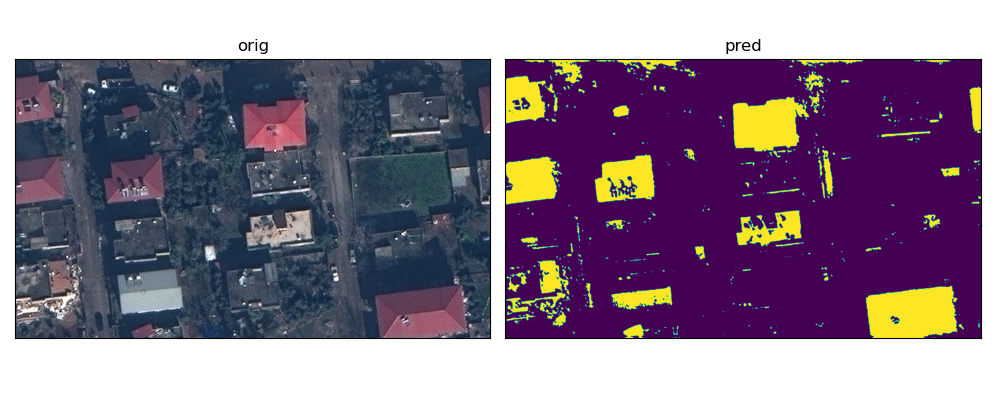

3 0


<IPython.core.display.Javascript object>


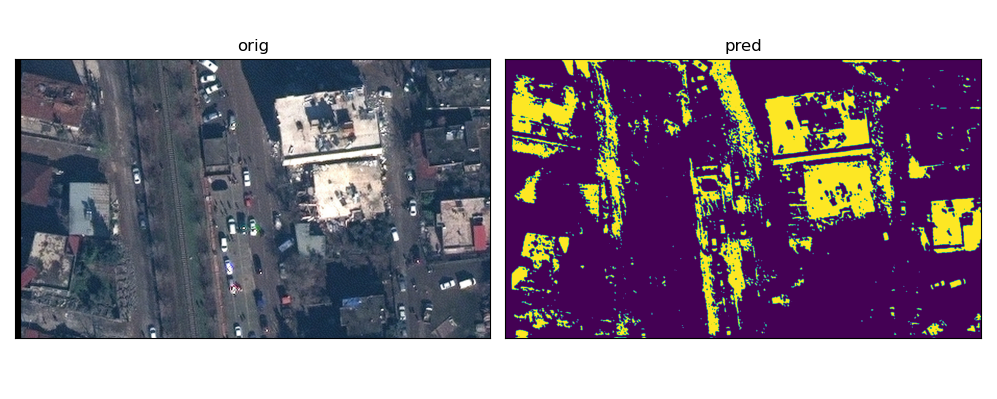

3 1


<IPython.core.display.Javascript object>


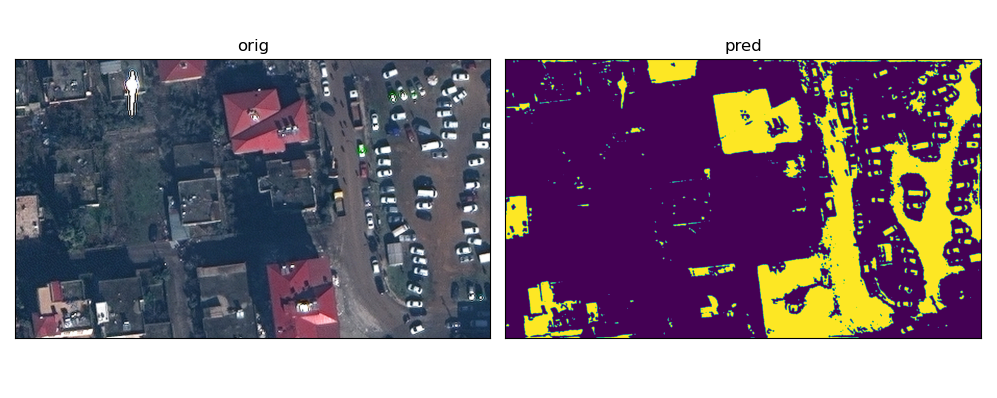

3 2


<IPython.core.display.Javascript object>


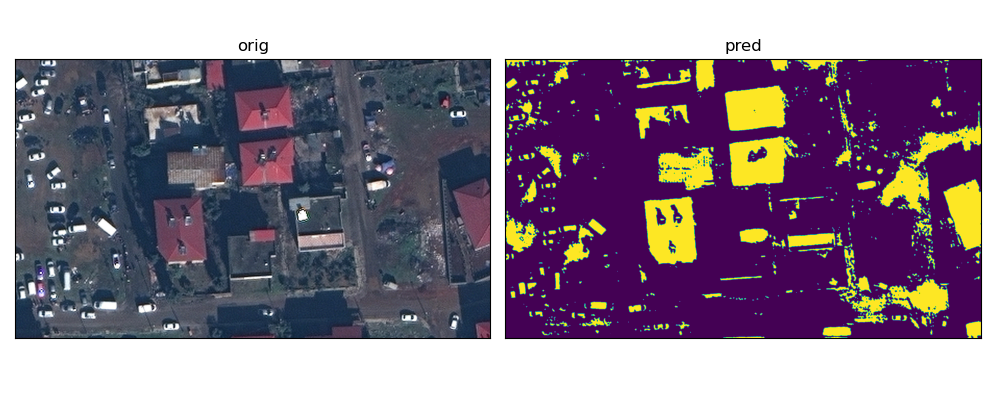

3 3


<IPython.core.display.Javascript object>


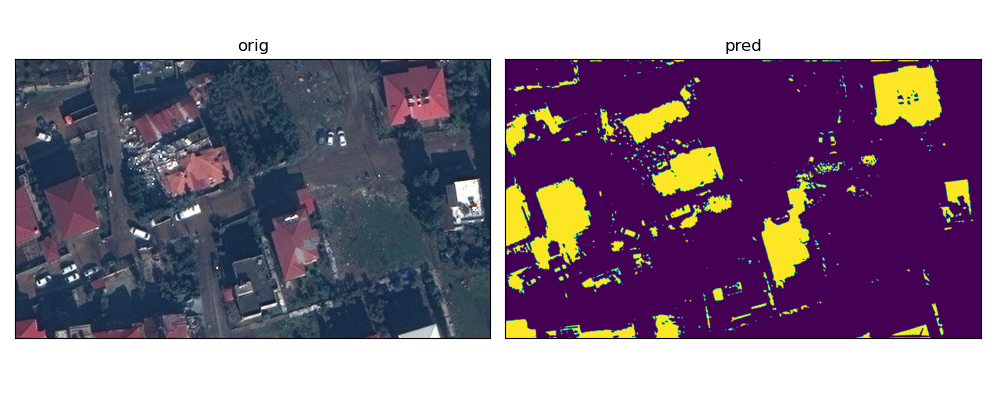

In [169]:
# Show tiled image predictions (akin to zooming in, easier to see details)
tiled_pred4 = np.zeros(
    [tiled_img4.shape[0], tiled_img4.shape[1], tiled_img4.shape[2], tiled_img4.shape[3]], dtype=np.uint8
)
for i in range(4):
    for j in range(4):
        print(i, j)
        pred4 = model_pred(tiled_img4_ch[i, j, ...,])
        show_pred(tiled_img4[i, j, ...,], pred4)
        tiled_pred4[i, j, ...] = pred4

In [174]:
tiled_pred4.shape

(4, 4, 1408, 2400)

In [175]:
pred4 = tiled_pred4.swapaxes(1, 2)
pred4 = pred4.reshape(test_imgs[4].shape[1], test_imgs[4].shape[2])

<IPython.core.display.Javascript object>


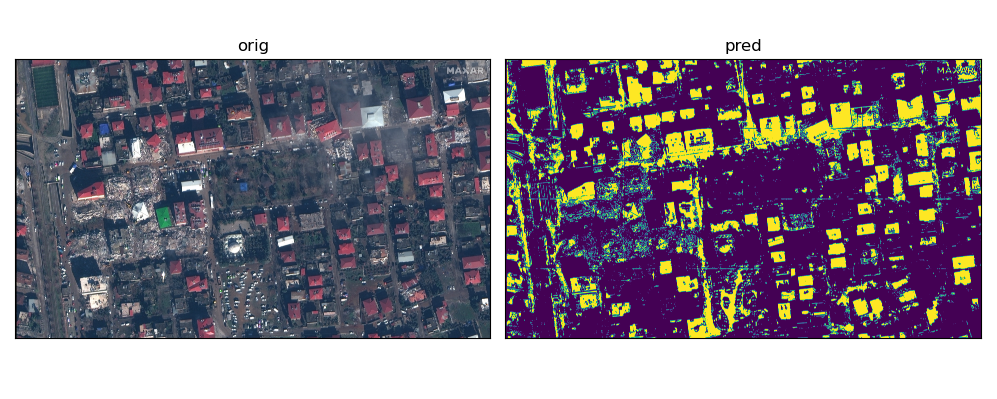

In [176]:
# Show full image prediction
show_pred(np.moveaxis(test_imgs[4], 0, -1), pred4)

**image_6**

<IPython.core.display.Javascript object>


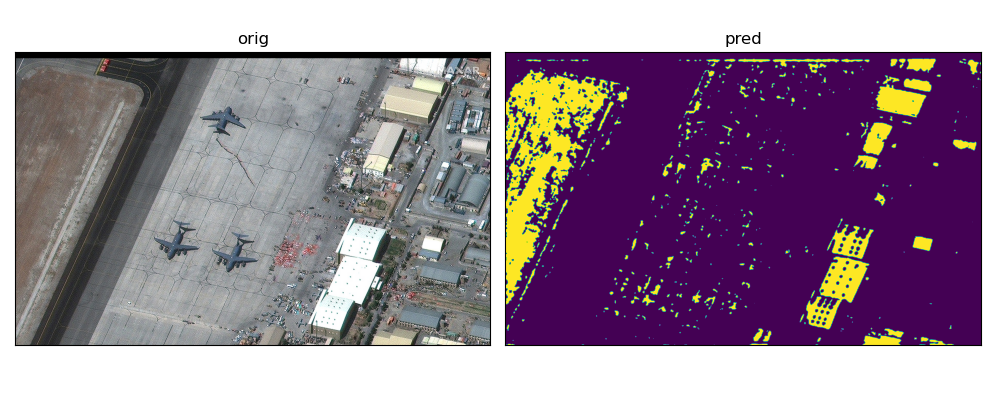

In [172]:
pred5 = model_pred(model, test_imgs[5])
show_pred(np.moveaxis(test_imgs[5], 0, -1), pred5)

<IPython.core.display.Javascript object>


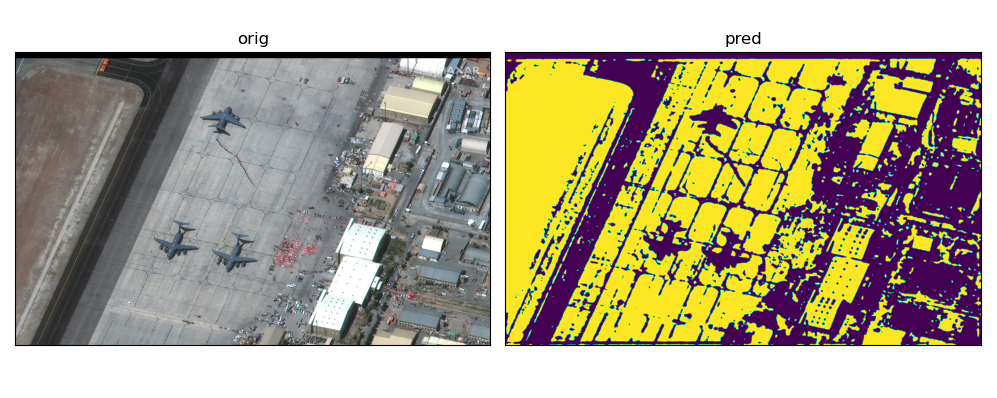

In [215]:
orig_pred5 = model_pred(model, test_orig_imgs[5])
show_pred(np.moveaxis(test_orig_imgs[5], 0, -1), orig_pred5)

In [200]:
preds = [pred0, pred1, pred2, pred3, pred4, pred5]

### Export predictions to GeoJSON

In [203]:
for e, p in enumerate(preds):
    features = []
    for geom, val in rio.features.shapes(p):
    #     print(geom)
        features.append(gj.Feature(geometry=geom))

    feature_collect = gj.FeatureCollection(features)

    with open(f'./output/pred_{e+1}.geojson', 'w') as f:
        gj.dump(feature_collect, f)

In [202]:
# Backup predictions as .npy files 
with open('./output/unet_predictions.npz', 'wb') as f:
    np.savez(f, pred0=pred0, pred1=pred1, pred2=pred2, pred3=pred3, pred4=pred4, pred5=pred5)

### Visualize superimposed building footprints

In [264]:
def vis_pred(img, pred, index, save=False):
    fig, ax = plt.subplots(figsize=(8,6))
    ax.set_aspect("equal")

    ax.imshow(np.moveaxis(img, 0, -1))

    for geom, val in rio.features.shapes(pred):
        coords = geom["coordinates"]
        x = [i for i,j in coords[0]]
        y = [j for i,j in coords[0]]
        ax.plot(x, y, color=("xkcd:sky blue", 0.8))
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
    
    if save:
        plt.savefig(f"./output/pred_{index}_vis.png", facecolor="k", edgecolor="k", bbox_inches="tight")
    
    plt.tight_layout()
    plt.show()

**image_1**

<IPython.core.display.Javascript object>


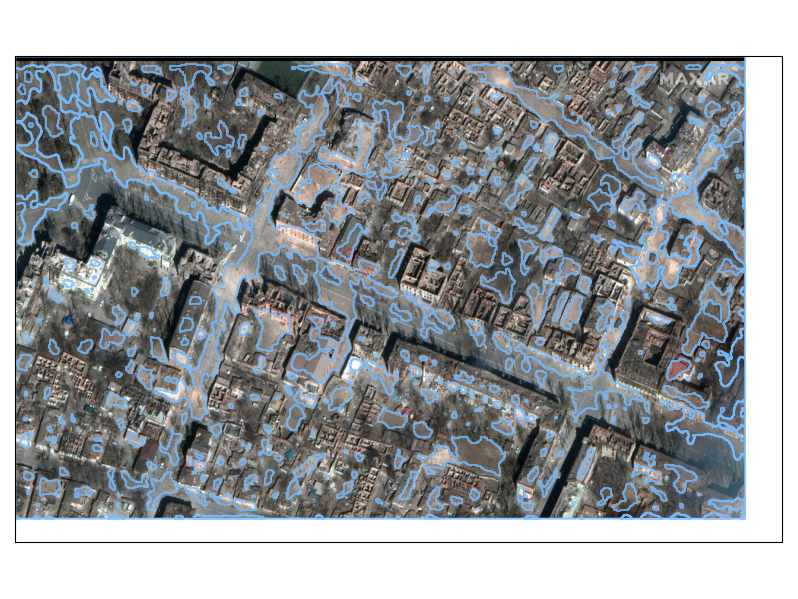

In [265]:
# prediction on original image
vis_pred(img=test_orig_imgs[0], pred=orig_pred0, index=1, save=True)

**image_2**

<IPython.core.display.Javascript object>


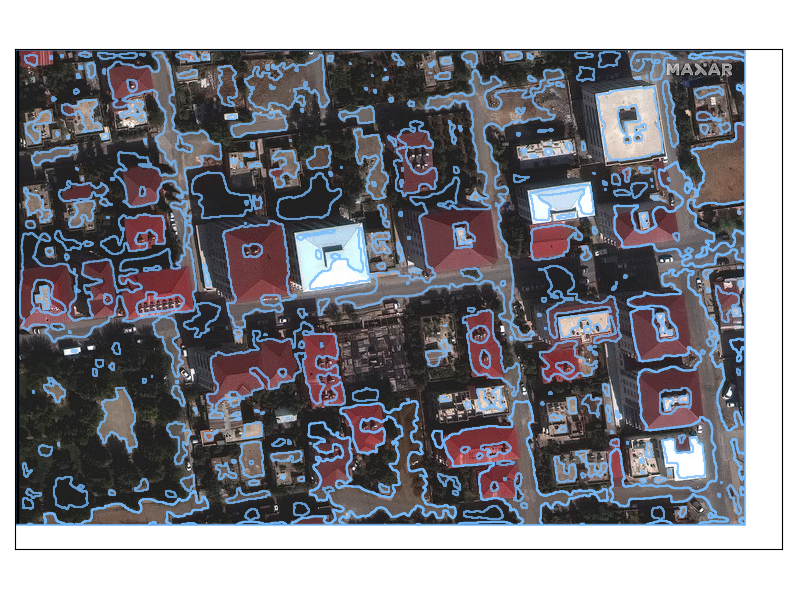

In [266]:
# prediction on sharpened image
vis_pred(img=test_imgs[1], pred=pred1, index=2, save=True)

**image_3**

<IPython.core.display.Javascript object>


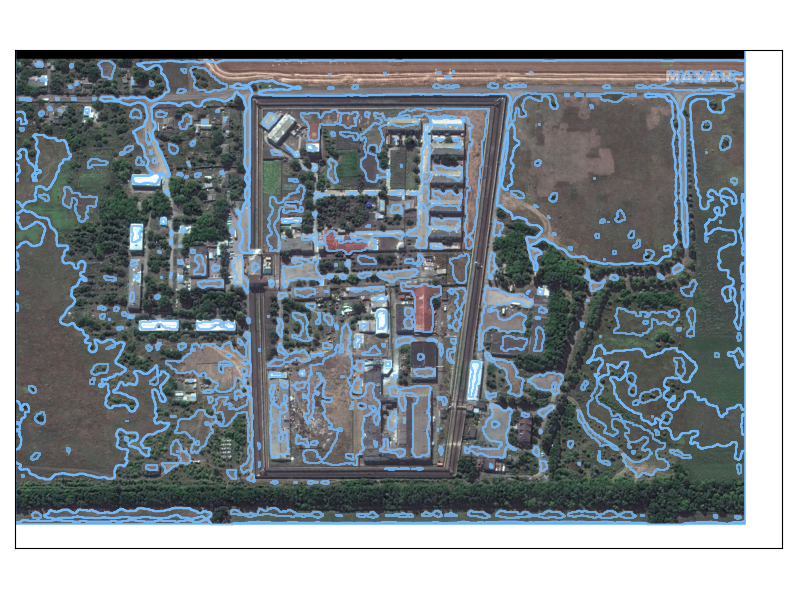

In [267]:
# prediction on original image
vis_pred(img=test_orig_imgs[2], pred=orig_pred2, index=3, save=True)

**image_4**

<IPython.core.display.Javascript object>


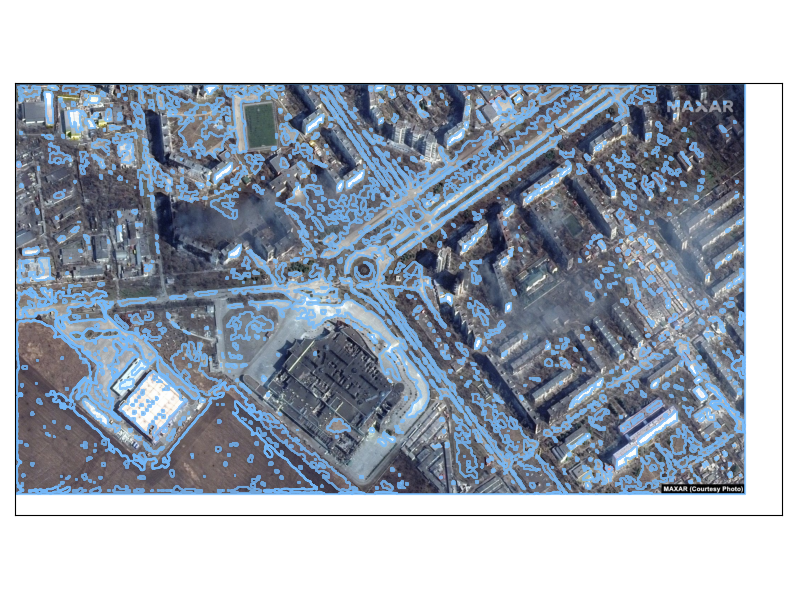

In [268]:
# prediction on original image
vis_pred(img=test_orig_imgs[3], pred=orig_pred3, index=4, save=True)

**image_5**

<IPython.core.display.Javascript object>


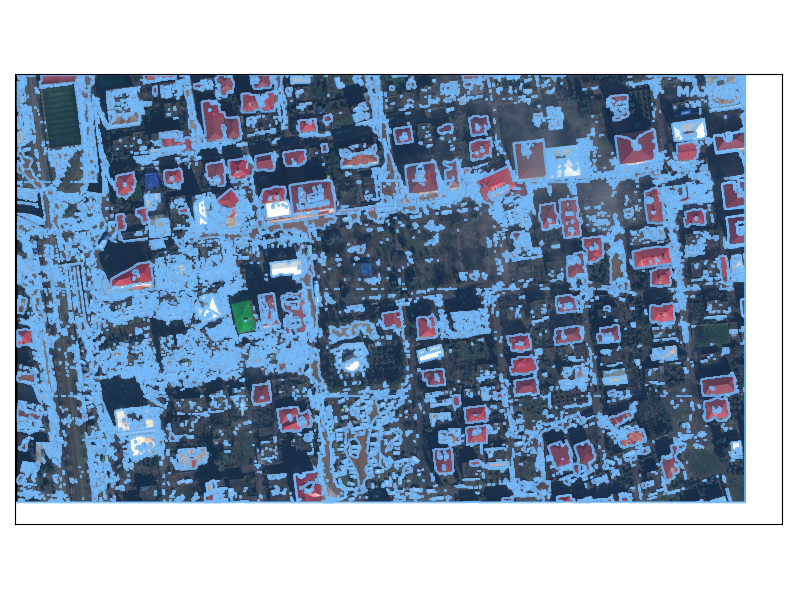

In [269]:
# prediction on sharpened image
vis_pred(img=test_imgs[4], pred=pred4, index=5, save=True)

**image_6**

<IPython.core.display.Javascript object>


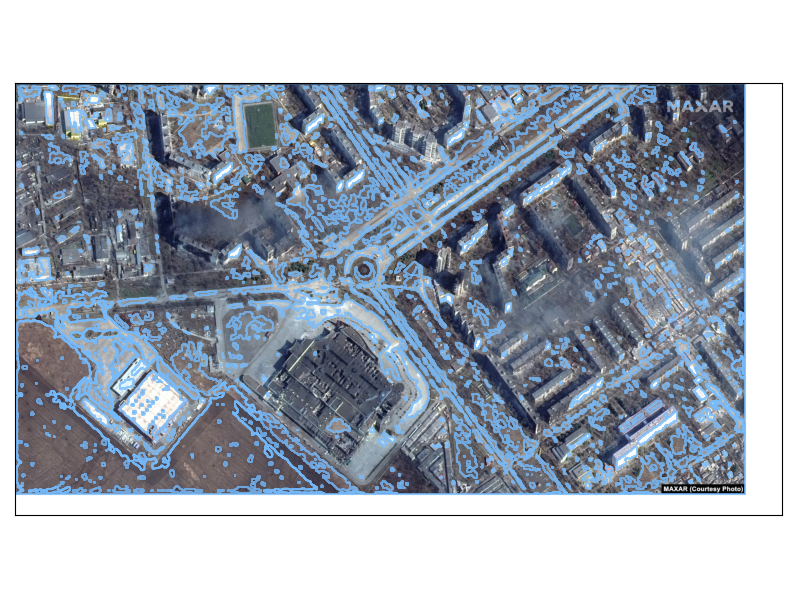

In [270]:
# prediction on original image
vis_pred(img=test_orig_imgs[3], pred=orig_pred3, index=4, save=True)